# NeRF a Representing Scenes as Neural Radiance Fields for View Synthesis

## Introduction
The main purpose of this work is directly optimizing parameters of a continuous 5D scene representation
to minimize the error of rendering a set of captured images.
We represent a static scene as a continuous 5D function that outputs the
radiance emitted in each direction (θ, φ) at each point (x, y, z) in space, and a
density at each point which acts like a differential opacity controlling how much
radiance is accumulated by a ray passing through (x, y, z). Our method optimizes
a deep fully-connected neural network without any convolutional layers (often
referred to as a multilayer perceptron or MLP) to represent this function by
regressing from a single 5D coordinate (x, y, z, θ, φ) to a single volume density
and view-dependent RGB color.
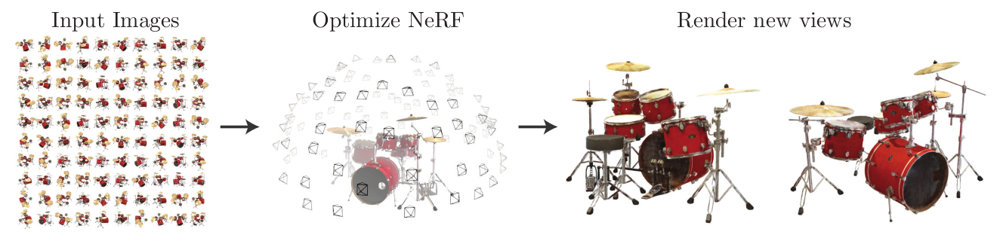
So to wrap this up the neural network would hypothetically *memorize* (overfit on) the
image. This means that our neural network would have encoded the entire image
in its weights. We could query the neural network with each position,
and it would eventually reconstruct the entire image.

## Neural Radiance Field Scene Representation
The representation here is a continuous scene as a 5D vector-valued function whose input is
a 3D location x = (x, y, z) and 2D viewing direction (θ, φ), and whose output
is an emitted color c = (r, g, b) and volume density σ. 
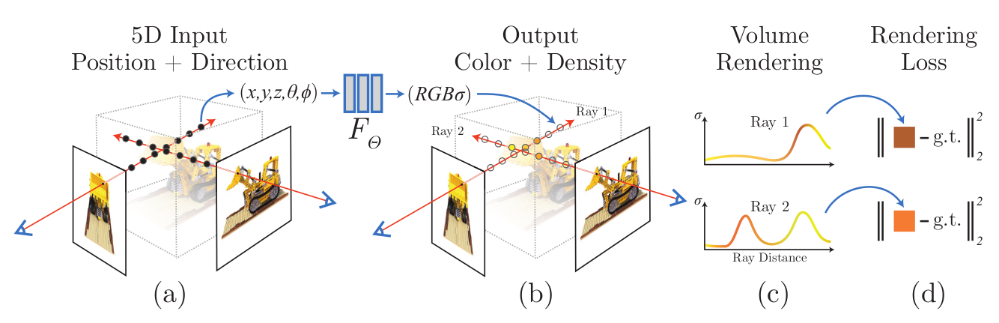
In practice, we express direction as a 3D Cartesian unit vector d. We approximate this continuous 5D
scene representation with an MLP network F Θ : (x, d) → (c, σ) and optimize its
weights Θ to map from each input 5D coordinate to its corresponding volume
density and directional emitted color.
We encourage the representation to be multiview consistent by restricting
the network to predict the volume density σ as a function of only the location
x, while allowing the RGB color c to be predicted as a function of both location
and viewing direction. To accomplish this, the MLP F Θ first processes the input
3D coordinate x with 8 fully-connected layers (using ReLU activations and 256
channels per layer), and outputs σ and a 256-dimensional feature vector. This
feature vector is then concatenated with the camera ray’s viewing direction and
passed to one additional fully-connected layer (using a ReLU activation and 128
channels) that output the view-dependent RGB color.

### Setting up the environment
importing the required dependencies and setting random seed to obtain reproducible results.

In [1]:
import tensorflow as tf

tf.random.set_seed(42)

import os
import glob
import imageio
import numpy as np
from tqdm import tqdm
from tensorflow import keras
from tensorflow.keras import layers
import matplotlib.pyplot as plt

In [2]:
# Initialize global variables.
AUTO = tf.data.AUTOTUNE
BATCH_SIZE = 5
NUM_SAMPLES = 32
POS_ENCODE_DIMS = 16
EPOCHS = 20

## Download and load the data
The `npz` data file contains images, camera poses, and a focal length.
The images are taken from multiple camera angles as shown in the introduction figure

To understand camera poses in this context we have to first allow
ourselves to think that a *camera is a mapping between the real-world
and the 2-D image*.
 ![mapping](https://www.mathworks.com/help/vision/ug/calibration_coordinate_blocks.png) 
Consider the following equation:
<img src="https://i.imgur.com/TQHKx5v.pngg" width="100" height="50"/>
Where **x** is the 2-D image point, **X** is the 3-D world point and
**P** is the camera-matrix. **P** is a 3 x 4 matrix that plays the
crucial role of mapping the real world object onto an image plane.
<img src="https://i.imgur.com/chvJct5.png" width="300" height="100"/>
The camera-matrix is an *affine transform matrix* that is
concatenated with a 3 x 1 column `[image height, image width, focal length]`
to produce the *pose matrix*. This matrix is of
dimensions 3 x 5 where the first 3 x 3 block is in the camera’s point
of view. The axes are `[down, right, backwards]` or `[-y, x, z]`
where the camera is facing forwards `-z`.
![camera-mapping](https://i.imgur.com/kvjqbiO.png) 
The COLMAP frame is `[right, down, forwards]` or `[x, -y, -z]`. Read
more about COLMAP [here](https://colmap.github.io/).

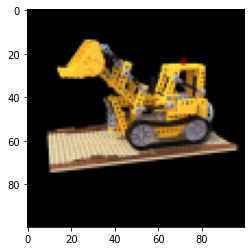

In [3]:
# Downloading the data as it does not already exist.
file_name = "tiny_nerf_data.npz"
url = "https://people.eecs.berkeley.edu/~bmild/nerf/tiny_nerf_data.npz"
if not os.path.exists(file_name):
    data = keras.utils.get_file(fname=file_name, origin=url)

data = np.load(data)
images = data["images"]
im_shape = images.shape
(num_images, H, W, _) = images.shape
(poses, focal) = (data["poses"], data["focal"])

# Plot a random image from the dataset for visualization.
plt.imshow(images[np.random.randint(low=0, high=num_images)])
plt.show()

## Volume Rendering with Radiance Fields

The 5D neural radiance field represents a scene as the volume density and di-
rectional emitted radiance at any point in space. We render the color of any ray
passing through the scene using principles from classical volume rendering.
The volume density σ(x) can be interpreted as the differential probability of a
ray terminating at an infinitesimal particle at location x. The expected color
C(r) of camera ray r(t) = o + td with near and far bounds t n and t f is:
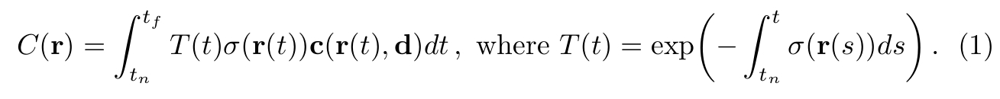
The function T (t) denotes the accumulated transmittance along the ray from
t n to t, i.e., the probability that the ray travels from t n to t without hitting
any other particle. Rendering a view from our continuous neural radiance field
requires estimating this integral C(r) for a camera ray traced through each pixel
of the desired virtual camera.

So to have a little bit of an insight here we consider a ray, and we sample some random points on
the ray. These sample points each have a unique location `(x, y, z)`
and the ray has a viewing angle `(theta, phi)`. The viewing angle is
particularly interesting as we can shoot a ray through a single pixel
in a lot of different ways, each with a unique viewing angle. Another
interesting thing to notice here is the noise that is added to the
sampling process. We add a uniform noise to each sample so that the
samples correspond to a continuous distribution. In **The nextFigure** the
blue points are the evenly distributed samples and the white points
`(t1, t2, t3)` are randomly placed between the samples.
 ![img](https://i.imgur.com/r9TS2wv.gif) 
Now to showcases the entire sampling process in 3D, where you
can see the rays coming out of the white image. This means that each
pixel will have its corresponding rays and each ray will be sampled at
distinct points.
 ![3-d rays](https://i.imgur.com/hr4D2g2.gif) 
These sampled points act as the input to the NeRF model. The model is
then asked to predict the RGB color and the volume density at that
point. 

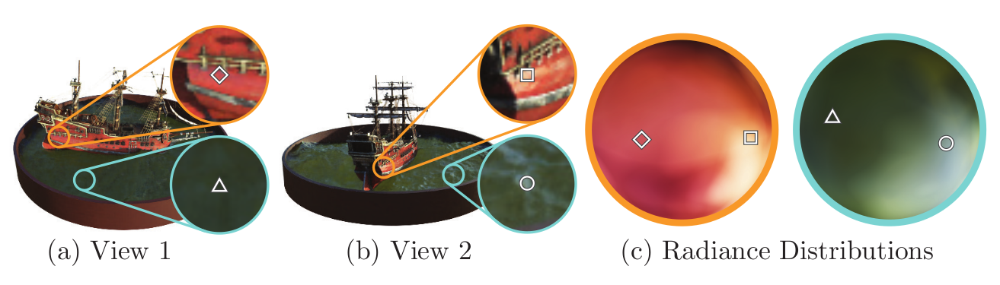

## Positional Encoding
Despite the fact that neural networks are universal function approximators,
we found that having the network F Θ directly operate on xyzθφ input coordi-
nates results in renderings that perform poorly at representing high-frequency
variation in color and geometry. This is consistent with recent work by Rahaman
et al, which shows that deep networks are biased towards learning lower fre-
quency functions. They additionally show that mapping the inputs to a higher
dimensional space using high frequency functions before passing them to the
network enables better fitting of data that contains high frequency variation.
We leverage these findings in the context of neural scene representations, and
show that reformulating F Θ as a composition of two functions F Θ = F Θ 0 ◦ γ, one
learned and one not, significantly improves performance .
Here γ is a mapping from R into a higher dimensional space R 2L , and F Θ 0 is still
simply a regular MLP. Formally, the encoding function we use is:
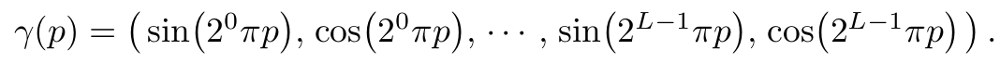

### Encoding the position into its corresponding feature.

In [4]:
def encode_position(x):
    """Encodes the position into its corresponding Fourier feature.
    Args:
        x: The input coordinate.
    Returns:
        Fourier features tensors of the position.
    """
    positions = [x]
    for i in range(POS_ENCODE_DIMS):
        for fn in [tf.sin, tf.cos]:
            positions.append(fn(2.0**i * x))
    return tf.concat(positions, axis=-1)


def get_rays(height, width, focal, pose):
    """Computes origin point and direction vector of rays.
    Args:
        height: Height of the image.
        width: Width of the image.
        focal: The focal length between the images and the camera.
        pose: The pose matrix of the camera.
    Returns:
        Tuple of origin point and direction vector for rays.
    """
    # Build a meshgrid for the rays.
    i, j = tf.meshgrid(
        tf.range(width, dtype=tf.float32),
        tf.range(height, dtype=tf.float32),
        indexing="xy",
    )

    # Normalize the x axis coordinates.
    transformed_i = (i - width * 0.5) / focal

    # Normalize the y axis coordinates.
    transformed_j = (j - height * 0.5) / focal

    # Create the direction unit vectors.
    directions = tf.stack([transformed_i, -transformed_j, -tf.ones_like(i)], axis=-1)

    # Get the camera matrix.
    camera_matrix = pose[:3, :3]
    height_width_focal = pose[:3, -1]

    # Get origins and directions for the rays.
    transformed_dirs = directions[..., None, :]
    camera_dirs = transformed_dirs * camera_matrix
    ray_directions = tf.reduce_sum(camera_dirs, axis=-1)
    ray_origins = tf.broadcast_to(height_width_focal, tf.shape(ray_directions))

    # Return the origins and directions.
    return (ray_origins, ray_directions)

### Rendering the rays and flattening them

In [5]:
def render_flat_rays(ray_origins, ray_directions, near, far, num_samples, rand=False):
    """Renders the rays and flattens it.
    Args:
        ray_origins: The origin points for rays.
        ray_directions: The direction unit vectors for the rays.
        near: The near bound of the volumetric scene.
        far: The far bound of the volumetric scene.
        num_samples: Number of sample points in a ray.
        rand: Choice for randomising the sampling strategy.
    Returns:
       Tuple of flattened rays and sample points on each rays.
    """
    # Compute 3D query points.
    # Equation: r(t) = o+td -> Building the "t" here.
    t_vals = tf.linspace(near, far, num_samples)
    if rand:
        # Inject uniform noise into sample space to make the sampling
        # continuous.
        shape = list(ray_origins.shape[:-1]) + [num_samples]
        noise = tf.random.uniform(shape=shape) * (far - near) / num_samples
        t_vals = t_vals + noise

    # Equation: r(t) = o + td -> Building the "r" here.
    rays = ray_origins[..., None, :] + (
        ray_directions[..., None, :] * t_vals[..., None]
    )
    rays_flat = tf.reshape(rays, [-1, 3])
    rays_flat = encode_position(rays_flat)
    return (rays_flat, t_vals)


### Maping individual pose to flattened rays and sample points

In [6]:
def map_fn(pose):
    """Maps individual pose to flattened rays and sample points.
    Args:
        pose: The pose matrix of the camera.
    Returns:
        Tuple of flattened rays and sample points corresponding to the
        camera pose.
    """
    (ray_origins, ray_directions) = get_rays(height=H, width=W, focal=focal, pose=pose)
    (rays_flat, t_vals) = render_flat_rays(
        ray_origins=ray_origins,
        ray_directions=ray_directions,
        near=2.0,
        far=6.0,
        num_samples=NUM_SAMPLES,
        rand=True,
    )
    return (rays_flat, t_vals)

In [7]:
# Create the training split.
split_index = int(num_images * 0.8)

# Split the images into training and validation.
train_images = images[:split_index]
val_images = images[split_index:]

# Split the poses into training and validation.
train_poses = poses[:split_index]
val_poses = poses[split_index:]

# Make the training pipeline.
train_img_ds = tf.data.Dataset.from_tensor_slices(train_images)
train_pose_ds = tf.data.Dataset.from_tensor_slices(train_poses)
train_ray_ds = train_pose_ds.map(map_fn, num_parallel_calls=AUTO)
training_ds = tf.data.Dataset.zip((train_img_ds, train_ray_ds))
train_ds = (
    training_ds.shuffle(BATCH_SIZE)
    .batch(BATCH_SIZE, drop_remainder=True, num_parallel_calls=AUTO)
    .prefetch(AUTO)
)

In [8]:
# Making the validation pipeline.
val_img_ds = tf.data.Dataset.from_tensor_slices(val_images)
val_pose_ds = tf.data.Dataset.from_tensor_slices(val_poses)
val_ray_ds = val_pose_ds.map(map_fn, num_parallel_calls=AUTO)
validation_ds = tf.data.Dataset.zip((val_img_ds, val_ray_ds))
val_ds = (
    validation_ds.shuffle(BATCH_SIZE)
    .batch(BATCH_SIZE, drop_remainder=True, num_parallel_calls=AUTO)
    .prefetch(AUTO)
)

## NeRF model
The model is a multi-layer perceptron (MLP), with ReLU as its non-linearity.
An excerpt from the paper:
**"We encourage the representation to be multiview-consistent by
restricting the network to predict the volume density sigma as a
function of only the location `x`, while allowing the RGB color `c` to be
predicted as a function of both location and viewing direction. To
accomplish this, the MLP first processes the input 3D coordinate `x`
with 8 fully-connected layers (using ReLU activations and 256 channels
per layer), and outputs sigma and a 256-dimensional feature vector.
This feature vector is then concatenated with the camera ray's viewing
direction and passed to one additional fully-connected layer (using a
ReLU activation and 128 channels) that output the view-dependent RGB
color."**
Here we have gone for a minimal implementation and have used 128 units as mentioned in paper.

In [9]:
def get_nerf_model(num_layers, num_pos):
    """Generates the NeRF neural network.
    Args:
        num_layers: The number of MLP layers.
        num_pos: The number of dimensions of positional encoding.
    Returns:
        The `tf.keras` model.
    """
    inputs = keras.Input(shape=(num_pos, 2 * 3 * POS_ENCODE_DIMS + 3))
    x = inputs
    for i in range(num_layers):
        x = layers.Dense(units=128, activation="relu")(x)
        if i % 4 == 0 and i > 0:
            # Inject residual connection.
            x = layers.concatenate([x, inputs], axis=-1)
    outputs = layers.Dense(units=4)(x)
    return keras.Model(inputs=inputs, outputs=outputs)

### Generating the RGB image and depth map from model prediction.

In [10]:
def render_rgb_depth(model, rays_flat, t_vals, rand=True, train=True):
    """Generates the RGB image and depth map from model prediction.
    Args:
        model: The MLP model that is trained to predict the rgb and
            volume density of the volumetric scene.
        rays_flat: The flattened rays that serve as the input to
            the NeRF model.
        t_vals: The sample points for the rays.
        rand: Choice to randomise the sampling strategy.
        train: Whether the model is in the training or testing phase.
    Returns:
        Tuple of rgb image and depth map.
    """
    # Get the predictions from the nerf model and reshape it.
    if train:
        predictions = model(rays_flat)
    else:
        predictions = model.predict(rays_flat)
    predictions = tf.reshape(predictions, shape=(BATCH_SIZE, H, W, NUM_SAMPLES, 4))

    # Slice the predictions into rgb and sigma.
    rgb = tf.sigmoid(predictions[..., :-1])
    sigma_a = tf.nn.relu(predictions[..., -1])

    # Get the distance of adjacent intervals.
    delta = t_vals[..., 1:] - t_vals[..., :-1]
    # delta shape = (num_samples)
    if rand:
        delta = tf.concat(
            [delta, tf.broadcast_to([1e10], shape=(BATCH_SIZE, H, W, 1))], axis=-1
        )
        alpha = 1.0 - tf.exp(-sigma_a * delta)
    else:
        delta = tf.concat(
            [delta, tf.broadcast_to([1e10], shape=(BATCH_SIZE, 1))], axis=-1
        )
        alpha = 1.0 - tf.exp(-sigma_a * delta[:, None, None, :])

    # Get transmittance.
    exp_term = 1.0 - alpha
    epsilon = 1e-10
    transmittance = tf.math.cumprod(exp_term + epsilon, axis=-1, exclusive=True)
    weights = alpha * transmittance
    rgb = tf.reduce_sum(weights[..., None] * rgb, axis=-2)

    if rand:
        depth_map = tf.reduce_sum(weights * t_vals, axis=-1)
    else:
        depth_map = tf.reduce_sum(weights * t_vals[:, None, None], axis=-1)
    return (rgb, depth_map)

## Training
The training step is implemented as part of a custom `keras.Model` subclass
so that we can make use of the `model.fit` functionality.

In [11]:
class NeRF(keras.Model):
    def __init__(self, nerf_model):
        super().__init__()
        self.nerf_model = nerf_model

    def compile(self, optimizer, loss_fn):
        super().compile()
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.loss_tracker = keras.metrics.Mean(name="loss")
        self.psnr_metric = keras.metrics.Mean(name="psnr")

    def train_step(self, inputs):
        # Get the images and the rays.
        (images, rays) = inputs
        (rays_flat, t_vals) = rays

        with tf.GradientTape() as tape:
            # Get the predictions from the model.
            rgb, _ = render_rgb_depth(
                model=self.nerf_model, rays_flat=rays_flat, t_vals=t_vals, rand=True
            )
            loss = self.loss_fn(images, rgb)

        # Get the trainable variables.
        trainable_variables = self.nerf_model.trainable_variables

        # Get the gradeints of the trainiable variables with respect to the loss.
        gradients = tape.gradient(loss, trainable_variables)

        # Apply the grads and optimize the model.
        self.optimizer.apply_gradients(zip(gradients, trainable_variables))

        # Get the PSNR of the reconstructed images and the source images.
        psnr = tf.image.psnr(images, rgb, max_val=1.0)

        # Compute our own metrics
        self.loss_tracker.update_state(loss)
        self.psnr_metric.update_state(psnr)
        return {"loss": self.loss_tracker.result(), "psnr": self.psnr_metric.result()}

    def test_step(self, inputs):
        # Get the images and the rays.
        (images, rays) = inputs
        (rays_flat, t_vals) = rays

        # Get the predictions from the model.
        rgb, _ = render_rgb_depth(
            model=self.nerf_model, rays_flat=rays_flat, t_vals=t_vals, rand=True
        )
        loss = self.loss_fn(images, rgb)

        # Get the PSNR of the reconstructed images and the source images.
        psnr = tf.image.psnr(images, rgb, max_val=1.0)

        # Compute our own metrics
        self.loss_tracker.update_state(loss)
        self.psnr_metric.update_state(psnr)
        return {"loss": self.loss_tracker.result(), "psnr": self.psnr_metric.result()}

    @property
    def metrics(self):
        return [self.loss_tracker, self.psnr_metric]

In [12]:
test_imgs, test_rays = next(iter(train_ds))
test_rays_flat, test_t_vals = test_rays
loss_list = []

In [13]:
class TrainMonitor(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        loss = logs["loss"]
        loss_list.append(loss)
        test_recons_images, depth_maps = render_rgb_depth(
            model=self.model.nerf_model,
            rays_flat=test_rays_flat,
            t_vals=test_t_vals,
            rand=True,
            train=False,
        )

        # Plot the rgb, depth and the loss plot.
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))
        ax[0].imshow(keras.preprocessing.image.array_to_img(test_recons_images[0]))
        ax[0].set_title(f"Predicted Image: {epoch:03d}")

        ax[1].imshow(keras.preprocessing.image.array_to_img(depth_maps[0, ..., None]))
        ax[1].set_title(f"Depth Map: {epoch:03d}")

        ax[2].plot(loss_list)
        ax[2].set_xticks(np.arange(0, EPOCHS + 1, 5.0))
        ax[2].set_title(f"Loss Plot: {epoch:03d}")

        fig.savefig(f"images/{epoch:03d}.png")
        plt.show()
        plt.close()

Epoch 1/50
16/16 [==============================] - ETA: 0s - loss: 0.0896 - psnr: 11.0301

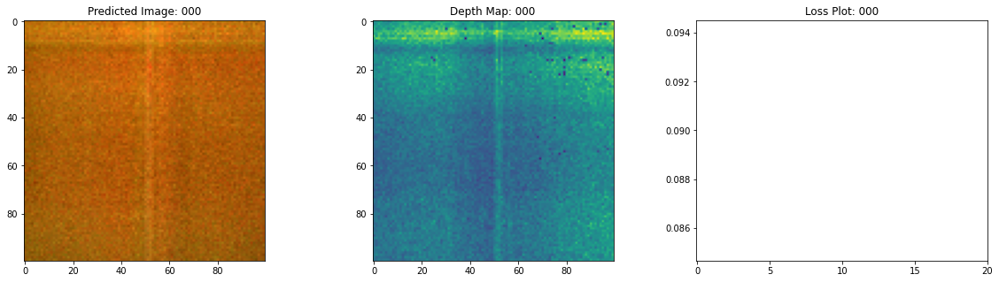

16/16 [==============================] - 33s 1s/step - loss: 0.0896 - psnr: 11.0301 - val_loss: 0.0713 - val_psnr: 11.9590
Epoch 2/50
16/16 [==============================] - ETA: 0s - loss: 0.0615 - psnr: 12.4764

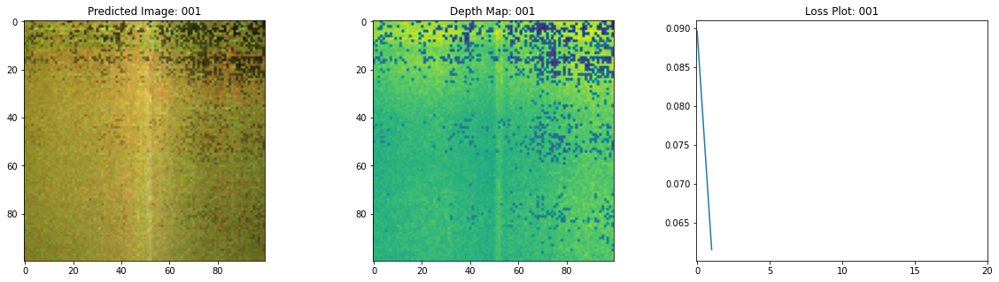

16/16 [==============================] - 24s 1s/step - loss: 0.0615 - psnr: 12.4764 - val_loss: 0.0651 - val_psnr: 12.3005
Epoch 3/50
16/16 [==============================] - ETA: 0s - loss: 0.0587 - psnr: 12.7456

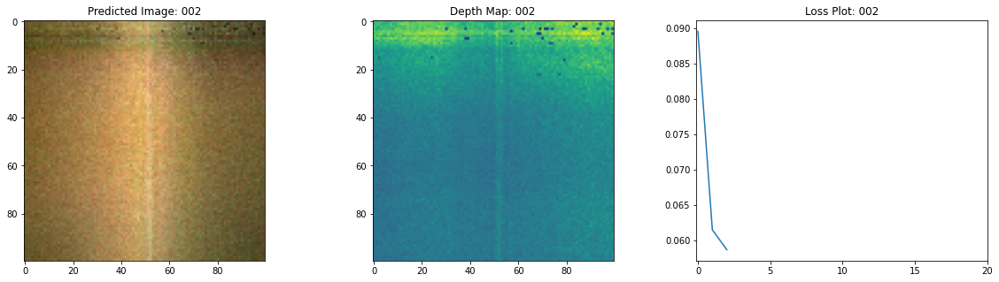

16/16 [==============================] - 24s 1s/step - loss: 0.0587 - psnr: 12.7456 - val_loss: 0.0637 - val_psnr: 12.2420
Epoch 4/50
16/16 [==============================] - ETA: 0s - loss: 0.0541 - psnr: 13.1230

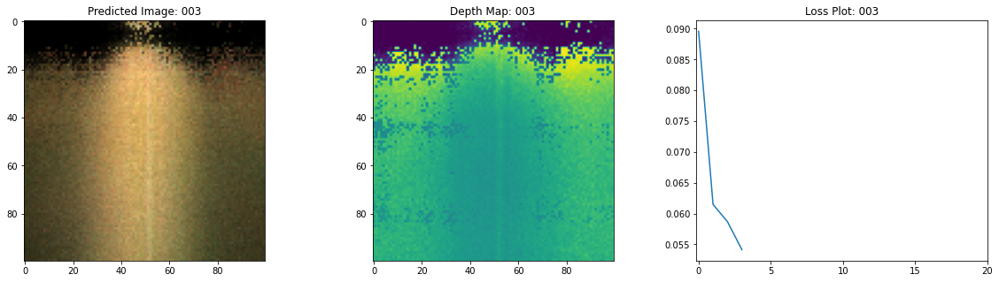

16/16 [==============================] - 24s 1s/step - loss: 0.0541 - psnr: 13.1230 - val_loss: 0.0537 - val_psnr: 13.0836
Epoch 5/50
16/16 [==============================] - ETA: 0s - loss: 0.0430 - psnr: 14.0845

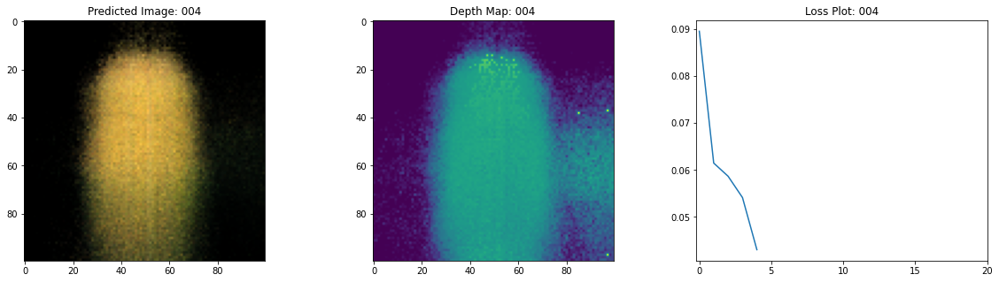

16/16 [==============================] - 24s 1s/step - loss: 0.0430 - psnr: 14.0845 - val_loss: 0.0371 - val_psnr: 14.5880
Epoch 6/50
16/16 [==============================] - ETA: 0s - loss: 0.0313 - psnr: 15.3530

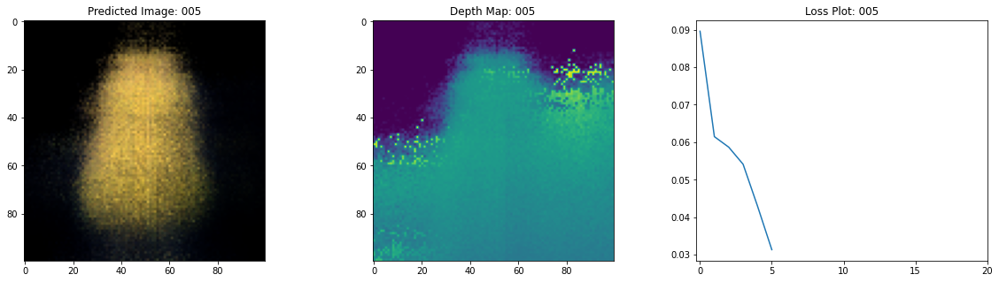

16/16 [==============================] - 23s 1s/step - loss: 0.0313 - psnr: 15.3530 - val_loss: 0.0304 - val_psnr: 15.3497
Epoch 7/50
16/16 [==============================] - ETA: 0s - loss: 0.0285 - psnr: 15.6828

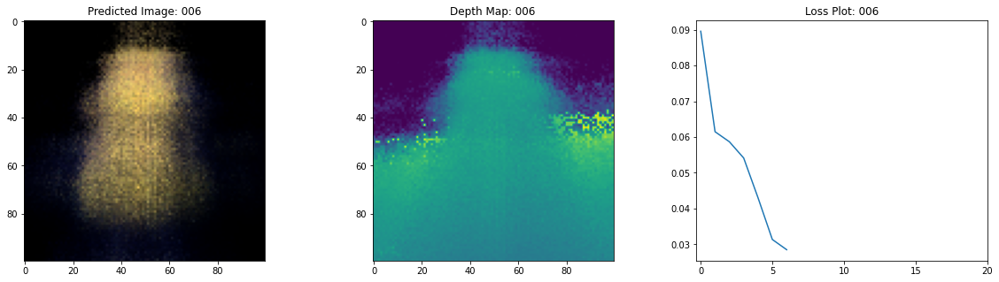

16/16 [==============================] - 24s 1s/step - loss: 0.0285 - psnr: 15.6828 - val_loss: 0.0293 - val_psnr: 15.4144
Epoch 8/50
16/16 [==============================] - ETA: 0s - loss: 0.0258 - psnr: 16.1414

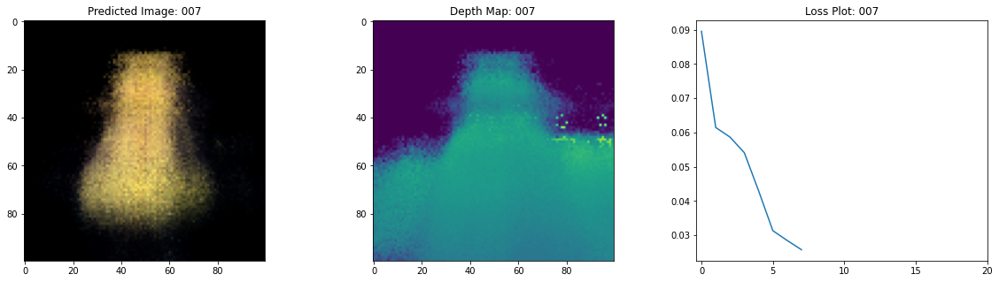

16/16 [==============================] - 23s 1s/step - loss: 0.0258 - psnr: 16.1414 - val_loss: 0.0245 - val_psnr: 16.2915
Epoch 9/50
16/16 [==============================] - ETA: 0s - loss: 0.0221 - psnr: 16.7592

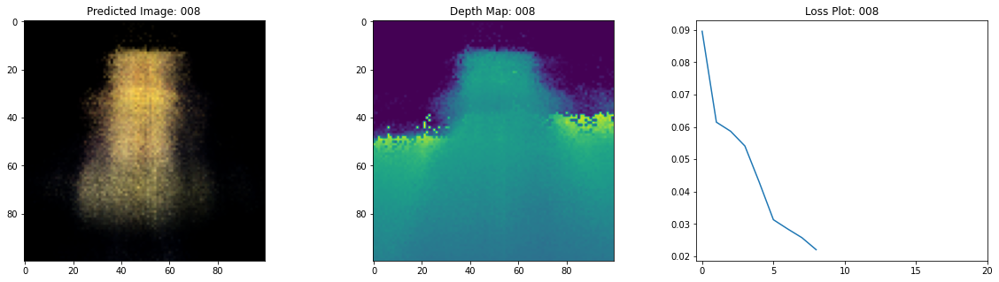

16/16 [==============================] - 23s 1s/step - loss: 0.0221 - psnr: 16.7592 - val_loss: 0.0210 - val_psnr: 16.8760
Epoch 10/50
16/16 [==============================] - ETA: 0s - loss: 0.0203 - psnr: 17.1072

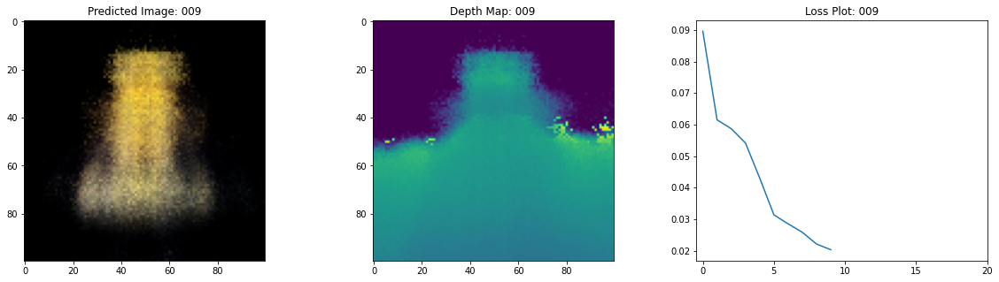

16/16 [==============================] - 23s 1s/step - loss: 0.0203 - psnr: 17.1072 - val_loss: 0.0181 - val_psnr: 17.4906
Epoch 11/50
16/16 [==============================] - ETA: 0s - loss: 0.0172 - psnr: 17.8088

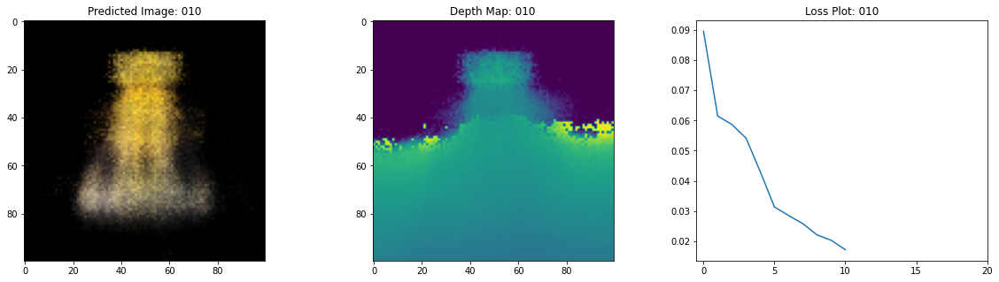

16/16 [==============================] - 23s 1s/step - loss: 0.0172 - psnr: 17.8088 - val_loss: 0.0161 - val_psnr: 18.0342
Epoch 12/50
16/16 [==============================] - ETA: 0s - loss: 0.0151 - psnr: 18.3492

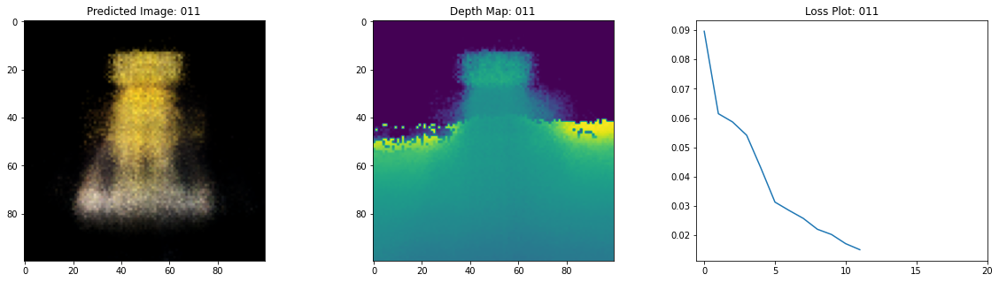

16/16 [==============================] - 24s 1s/step - loss: 0.0151 - psnr: 18.3492 - val_loss: 0.0147 - val_psnr: 18.4211
Epoch 13/50
16/16 [==============================] - ETA: 0s - loss: 0.0143 - psnr: 18.5967

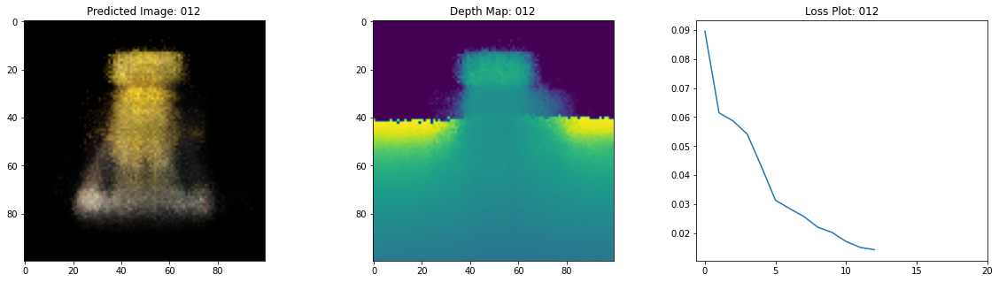

16/16 [==============================] - 24s 1s/step - loss: 0.0143 - psnr: 18.5967 - val_loss: 0.0143 - val_psnr: 18.5359
Epoch 14/50
16/16 [==============================] - ETA: 0s - loss: 0.0136 - psnr: 18.8164

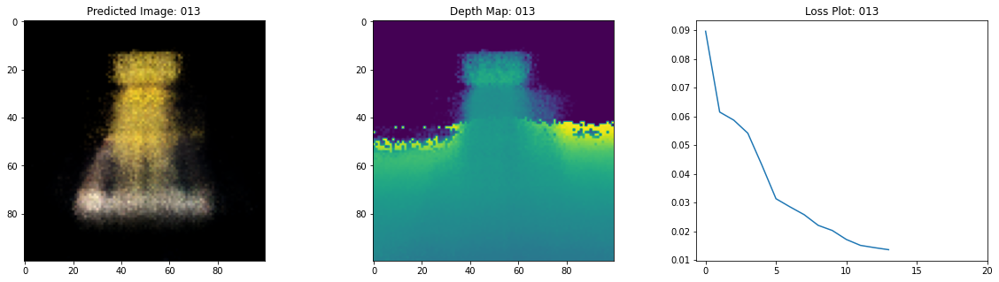

16/16 [==============================] - 24s 1s/step - loss: 0.0136 - psnr: 18.8164 - val_loss: 0.0132 - val_psnr: 18.9079
Epoch 15/50
16/16 [==============================] - ETA: 0s - loss: 0.0125 - psnr: 19.1811

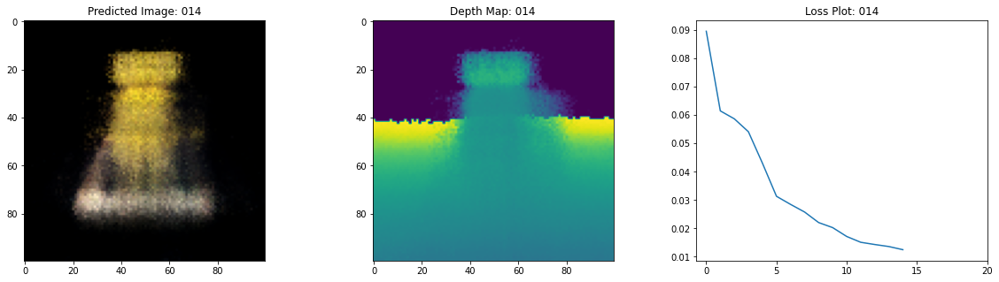

16/16 [==============================] - 24s 1s/step - loss: 0.0125 - psnr: 19.1811 - val_loss: 0.0124 - val_psnr: 19.1652
Epoch 16/50
16/16 [==============================] - ETA: 0s - loss: 0.0125 - psnr: 19.1490

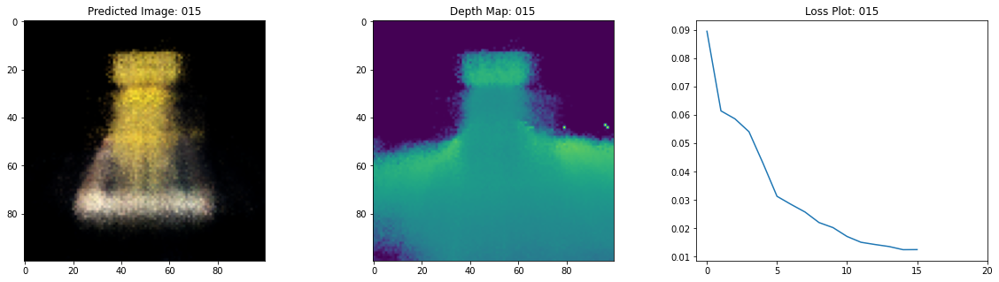

16/16 [==============================] - 24s 1s/step - loss: 0.0125 - psnr: 19.1490 - val_loss: 0.0131 - val_psnr: 18.8623
Epoch 17/50
16/16 [==============================] - ETA: 0s - loss: 0.0122 - psnr: 19.2894

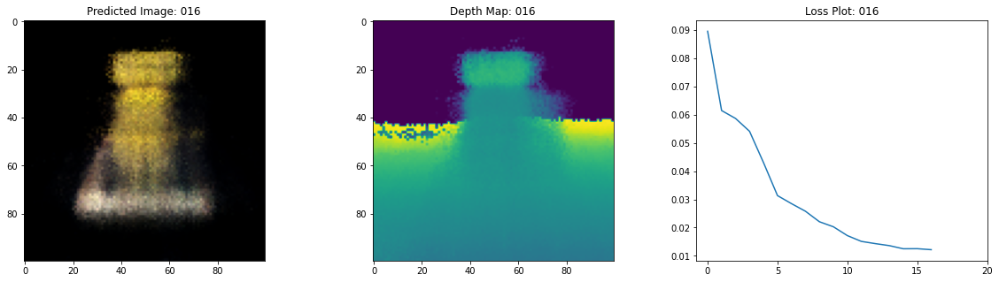

16/16 [==============================] - 24s 1s/step - loss: 0.0122 - psnr: 19.2894 - val_loss: 0.0118 - val_psnr: 19.4060
Epoch 18/50
16/16 [==============================] - ETA: 0s - loss: 0.0113 - psnr: 19.6328

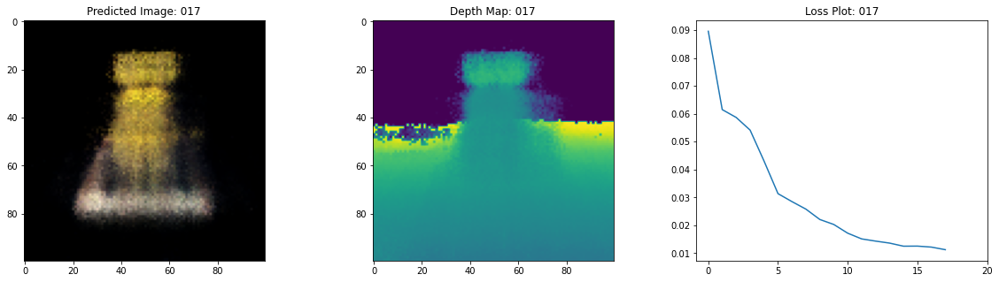

16/16 [==============================] - 23s 1s/step - loss: 0.0113 - psnr: 19.6328 - val_loss: 0.0118 - val_psnr: 19.3665
Epoch 19/50
16/16 [==============================] - ETA: 0s - loss: 0.0106 - psnr: 19.8945

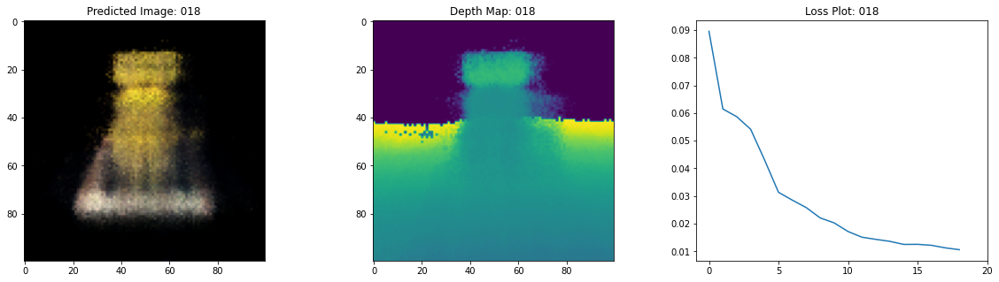

16/16 [==============================] - 24s 1s/step - loss: 0.0106 - psnr: 19.8945 - val_loss: 0.0108 - val_psnr: 19.7504
Epoch 20/50
16/16 [==============================] - ETA: 0s - loss: 0.0106 - psnr: 19.8703

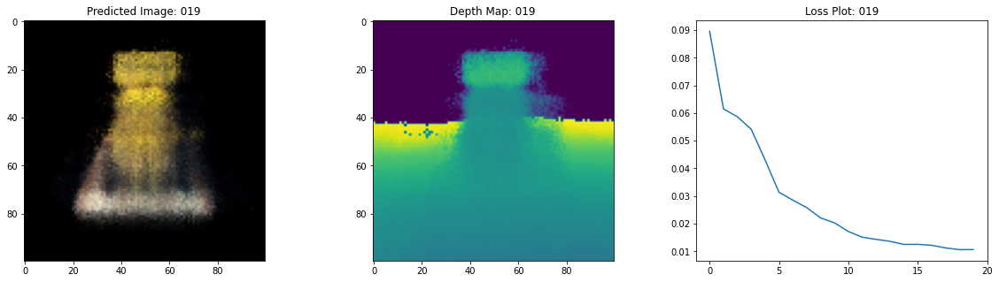

16/16 [==============================] - 23s 1s/step - loss: 0.0106 - psnr: 19.8703 - val_loss: 0.0108 - val_psnr: 19.7396
Epoch 21/50
16/16 [==============================] - ETA: 0s - loss: 0.0102 - psnr: 20.0563

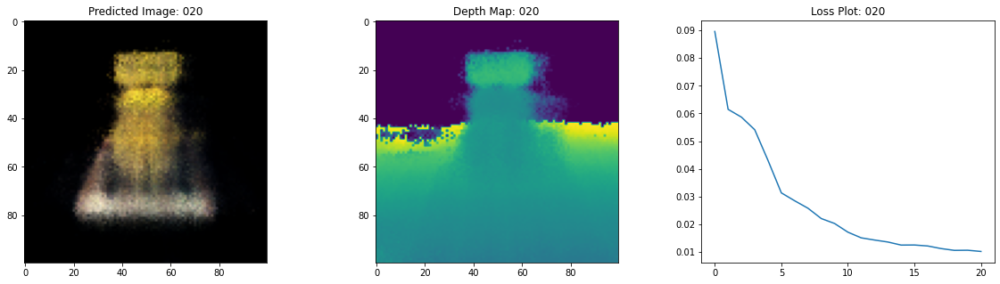

16/16 [==============================] - 24s 1s/step - loss: 0.0102 - psnr: 20.0563 - val_loss: 0.0104 - val_psnr: 19.9410
Epoch 22/50
16/16 [==============================] - ETA: 0s - loss: 0.0098 - psnr: 20.2025

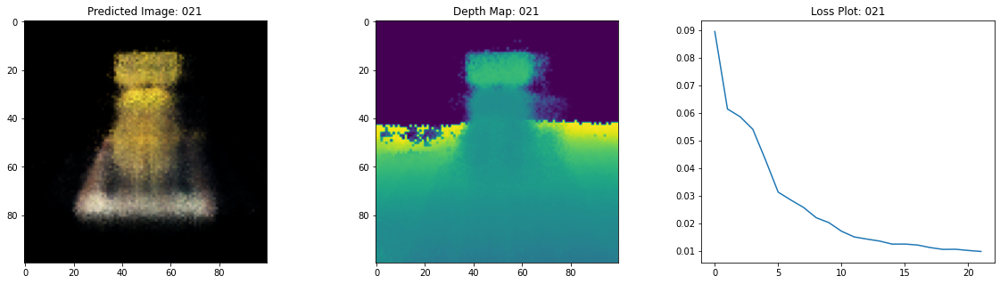

16/16 [==============================] - 24s 1s/step - loss: 0.0098 - psnr: 20.2025 - val_loss: 0.0105 - val_psnr: 19.8555
Epoch 23/50
16/16 [==============================] - ETA: 0s - loss: 0.0097 - psnr: 20.2704

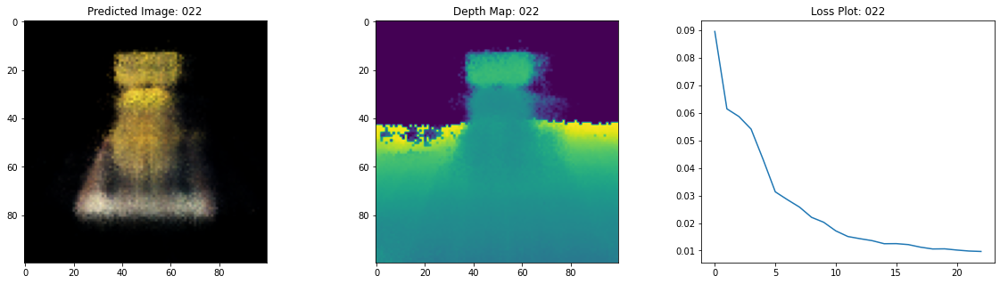

16/16 [==============================] - 23s 1s/step - loss: 0.0097 - psnr: 20.2704 - val_loss: 0.0098 - val_psnr: 20.1647
Epoch 24/50
16/16 [==============================] - ETA: 0s - loss: 0.0092 - psnr: 20.5021

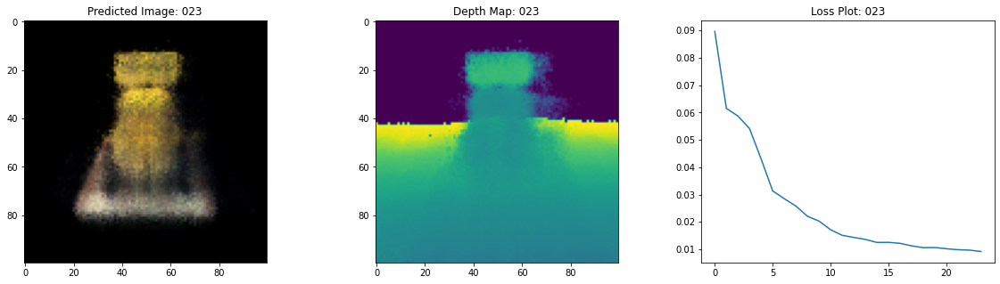

16/16 [==============================] - 24s 1s/step - loss: 0.0092 - psnr: 20.5021 - val_loss: 0.0097 - val_psnr: 20.2340
Epoch 25/50
16/16 [==============================] - ETA: 0s - loss: 0.0091 - psnr: 20.5488

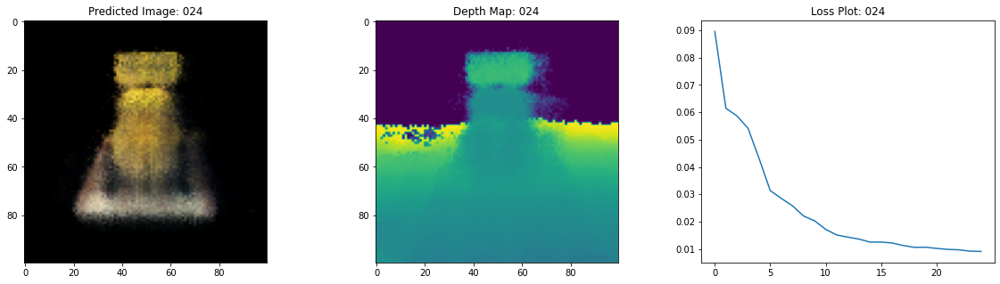

16/16 [==============================] - 24s 1s/step - loss: 0.0091 - psnr: 20.5488 - val_loss: 0.0095 - val_psnr: 20.3341
Epoch 26/50
16/16 [==============================] - ETA: 0s - loss: 0.0090 - psnr: 20.6086

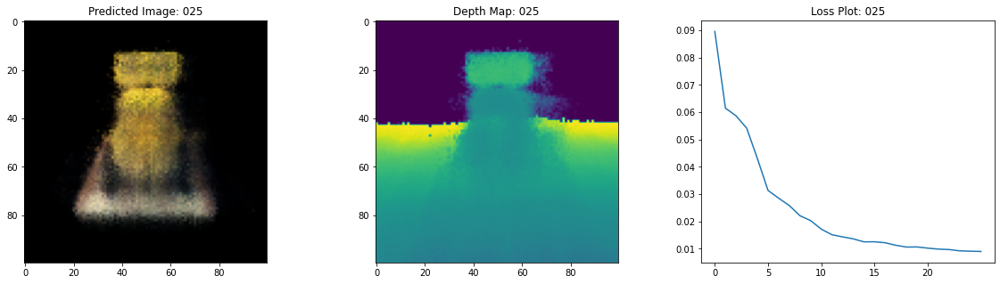

16/16 [==============================] - 23s 1s/step - loss: 0.0090 - psnr: 20.6086 - val_loss: 0.0097 - val_psnr: 20.1757
Epoch 27/50
16/16 [==============================] - ETA: 0s - loss: 0.0089 - psnr: 20.6638

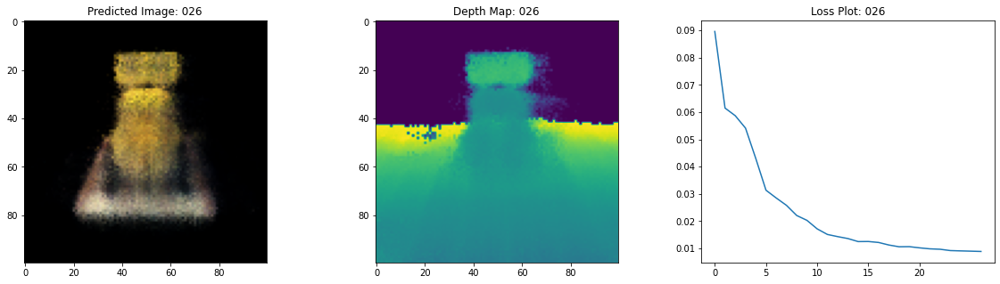

16/16 [==============================] - 24s 1s/step - loss: 0.0089 - psnr: 20.6638 - val_loss: 0.0095 - val_psnr: 20.3064
Epoch 28/50
16/16 [==============================] - ETA: 0s - loss: 0.0086 - psnr: 20.7899

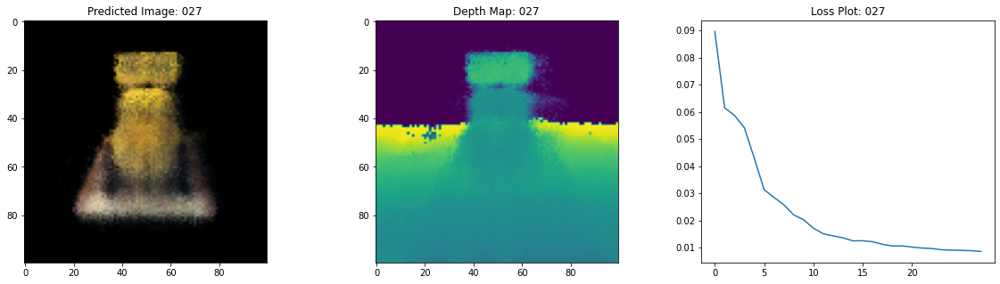

16/16 [==============================] - 24s 1s/step - loss: 0.0086 - psnr: 20.7899 - val_loss: 0.0094 - val_psnr: 20.3552
Epoch 29/50
16/16 [==============================] - ETA: 0s - loss: 0.0084 - psnr: 20.8889

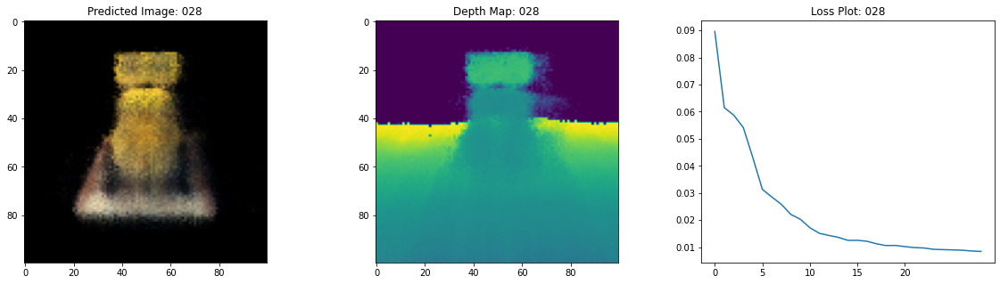

16/16 [==============================] - 23s 1s/step - loss: 0.0084 - psnr: 20.8889 - val_loss: 0.0092 - val_psnr: 20.4458
Epoch 30/50
16/16 [==============================] - ETA: 0s - loss: 0.0083 - psnr: 20.9134

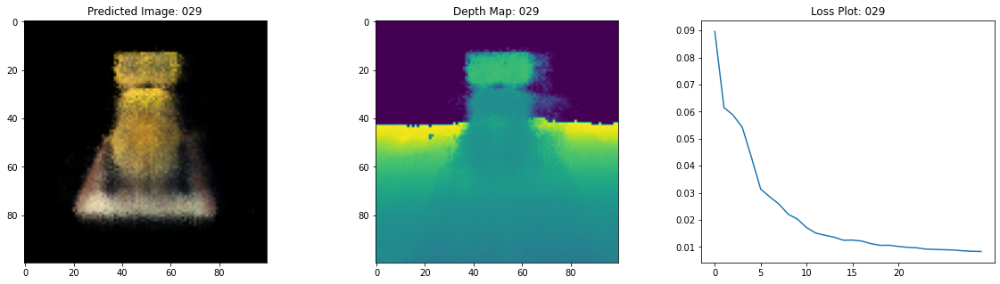

16/16 [==============================] - 24s 1s/step - loss: 0.0083 - psnr: 20.9134 - val_loss: 0.0088 - val_psnr: 20.6400
Epoch 31/50
16/16 [==============================] - ETA: 0s - loss: 0.0083 - psnr: 20.9163

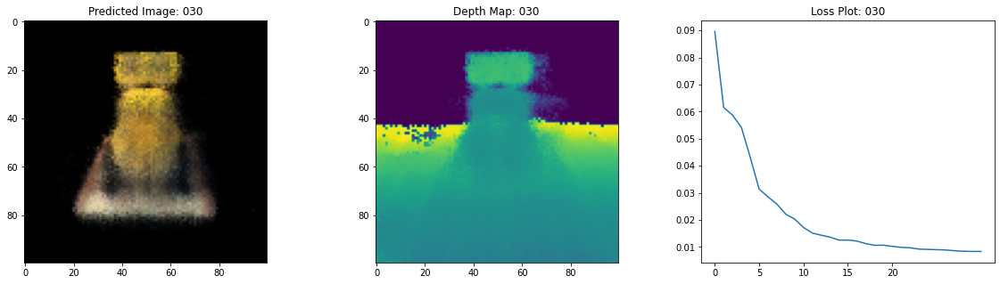

16/16 [==============================] - 24s 1s/step - loss: 0.0083 - psnr: 20.9163 - val_loss: 0.0088 - val_psnr: 20.6425
Epoch 32/50
16/16 [==============================] - ETA: 0s - loss: 0.0079 - psnr: 21.1453

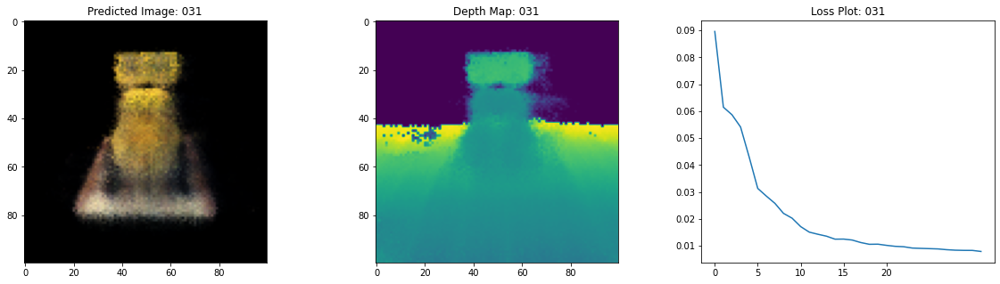

16/16 [==============================] - 24s 1s/step - loss: 0.0079 - psnr: 21.1453 - val_loss: 0.0090 - val_psnr: 20.5641
Epoch 33/50
16/16 [==============================] - ETA: 0s - loss: 0.0080 - psnr: 21.1356

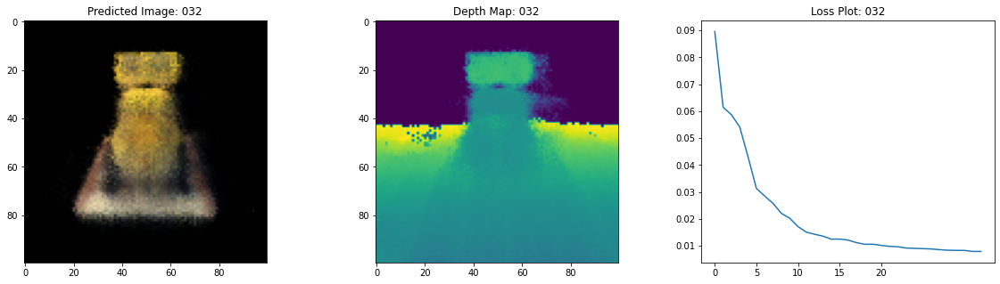

16/16 [==============================] - 24s 1s/step - loss: 0.0080 - psnr: 21.1356 - val_loss: 0.0088 - val_psnr: 20.6609
Epoch 34/50
16/16 [==============================] - ETA: 0s - loss: 0.0080 - psnr: 21.1144

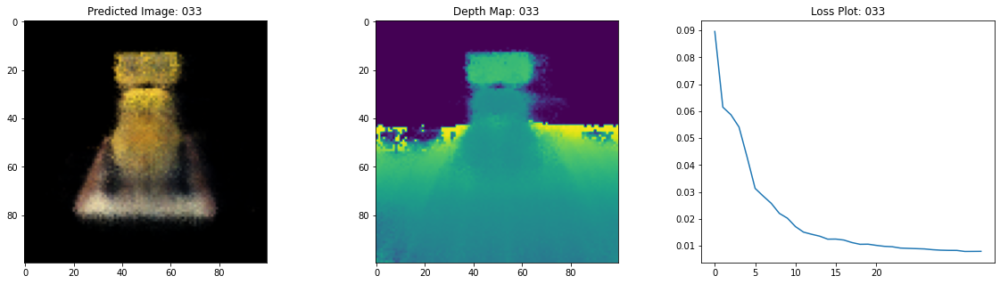

16/16 [==============================] - 24s 1s/step - loss: 0.0080 - psnr: 21.1144 - val_loss: 0.0086 - val_psnr: 20.7553
Epoch 35/50
16/16 [==============================] - ETA: 0s - loss: 0.0078 - psnr: 21.2288

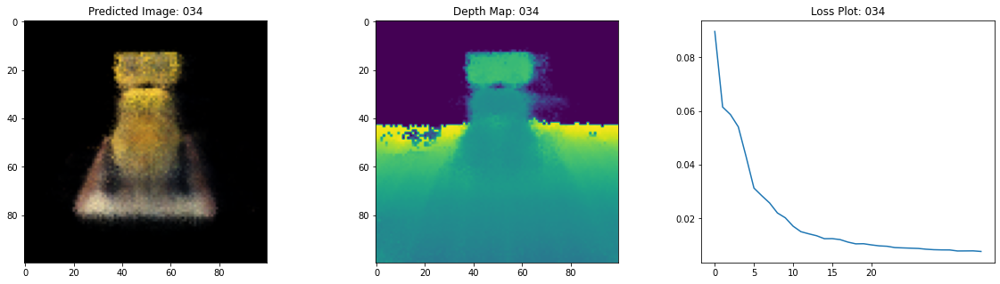

16/16 [==============================] - 24s 1s/step - loss: 0.0078 - psnr: 21.2288 - val_loss: 0.0087 - val_psnr: 20.7011
Epoch 36/50
16/16 [==============================] - ETA: 0s - loss: 0.0077 - psnr: 21.2658

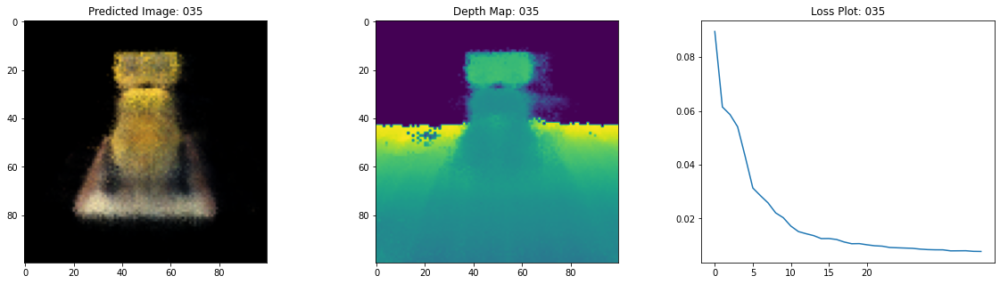

16/16 [==============================] - 24s 1s/step - loss: 0.0077 - psnr: 21.2658 - val_loss: 0.0087 - val_psnr: 20.6751
Epoch 37/50
16/16 [==============================] - ETA: 0s - loss: 0.0075 - psnr: 21.3756

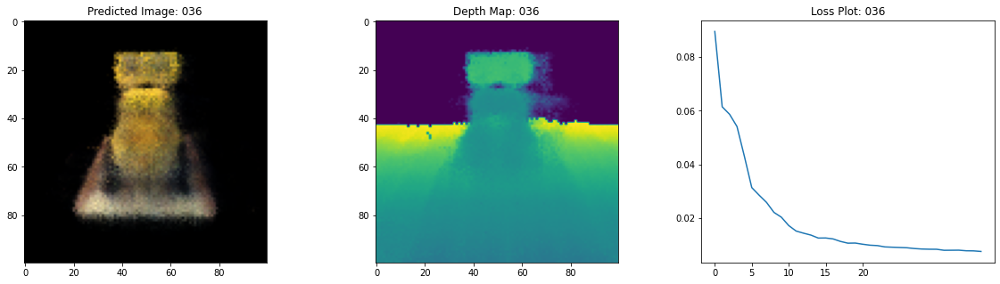

16/16 [==============================] - 24s 1s/step - loss: 0.0075 - psnr: 21.3756 - val_loss: 0.0083 - val_psnr: 20.9291
Epoch 38/50
16/16 [==============================] - ETA: 0s - loss: 0.0075 - psnr: 21.3685

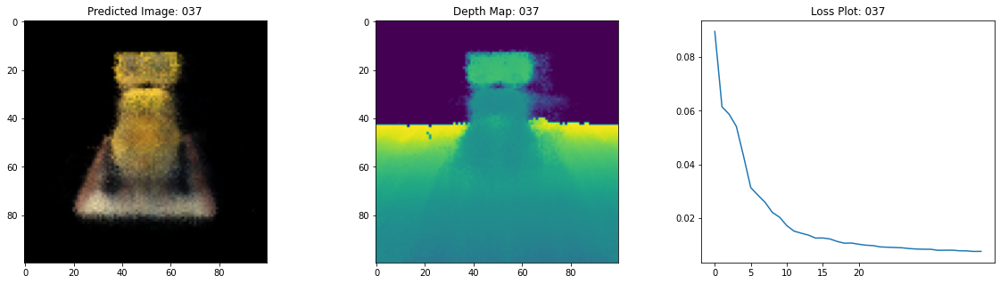

16/16 [==============================] - 25s 1s/step - loss: 0.0075 - psnr: 21.3685 - val_loss: 0.0084 - val_psnr: 20.8637
Epoch 39/50
16/16 [==============================] - ETA: 0s - loss: 0.0075 - psnr: 21.3949

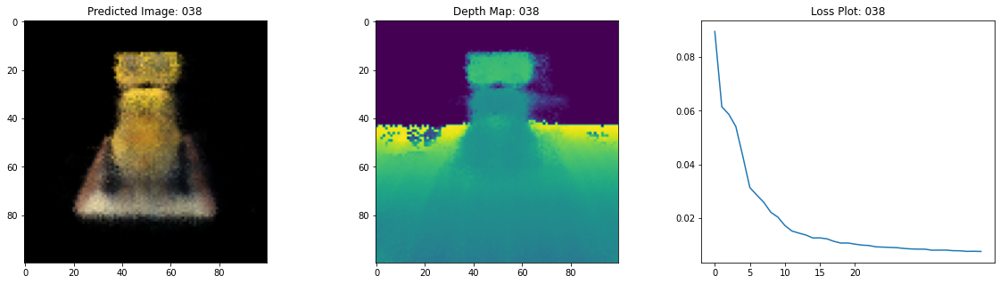

16/16 [==============================] - 23s 1s/step - loss: 0.0075 - psnr: 21.3949 - val_loss: 0.0082 - val_psnr: 20.9550
Epoch 40/50
16/16 [==============================] - ETA: 0s - loss: 0.0076 - psnr: 21.3052

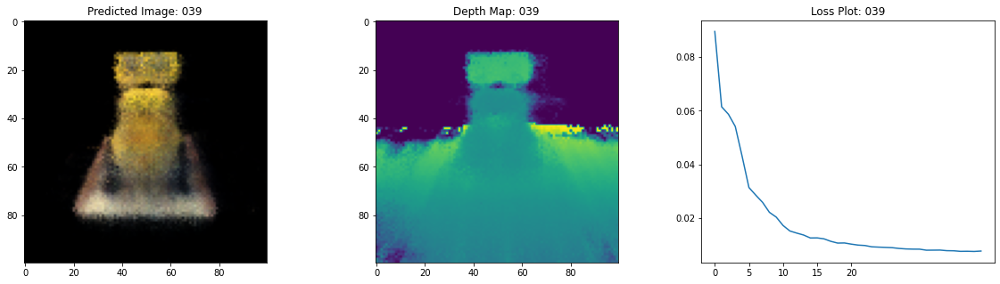

16/16 [==============================] - 24s 1s/step - loss: 0.0076 - psnr: 21.3052 - val_loss: 0.0087 - val_psnr: 20.6480
Epoch 41/50
16/16 [==============================] - ETA: 0s - loss: 0.0074 - psnr: 21.4484

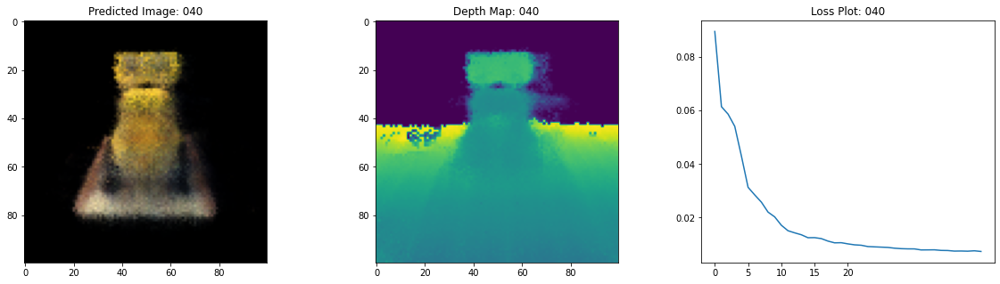

16/16 [==============================] - 24s 1s/step - loss: 0.0074 - psnr: 21.4484 - val_loss: 0.0084 - val_psnr: 20.8662
Epoch 42/50
16/16 [==============================] - ETA: 0s - loss: 0.0072 - psnr: 21.5819

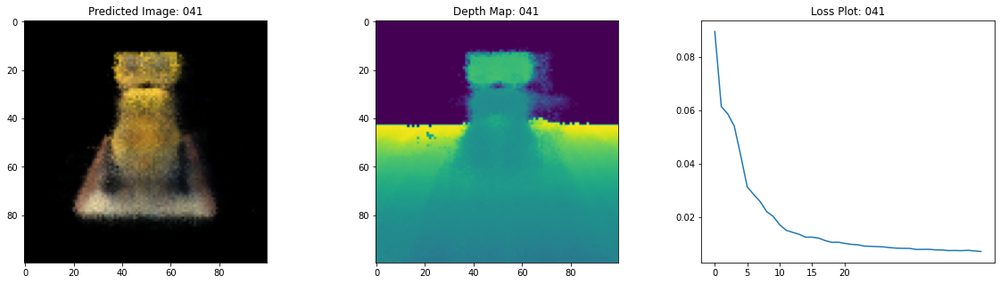

16/16 [==============================] - 24s 1s/step - loss: 0.0072 - psnr: 21.5819 - val_loss: 0.0082 - val_psnr: 20.9731
Epoch 43/50
16/16 [==============================] - ETA: 0s - loss: 0.0070 - psnr: 21.6407

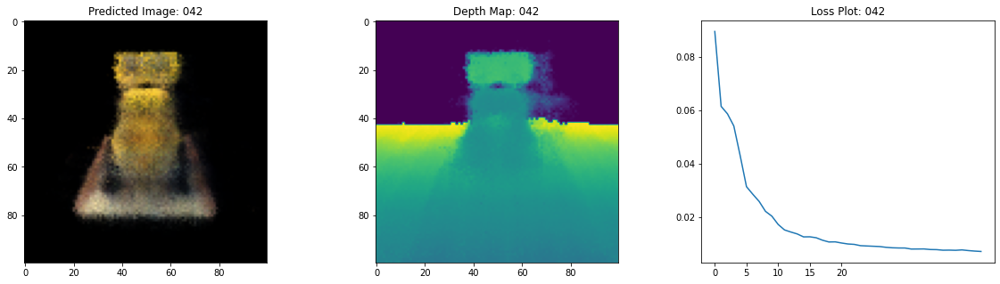

16/16 [==============================] - 24s 1s/step - loss: 0.0070 - psnr: 21.6407 - val_loss: 0.0081 - val_psnr: 21.0507
Epoch 44/50
16/16 [==============================] - ETA: 0s - loss: 0.0070 - psnr: 21.6826

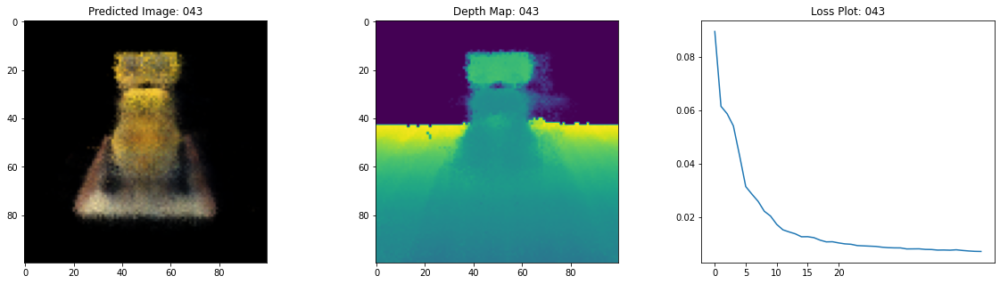

16/16 [==============================] - 24s 1s/step - loss: 0.0070 - psnr: 21.6826 - val_loss: 0.0079 - val_psnr: 21.1430
Epoch 45/50
16/16 [==============================] - ETA: 0s - loss: 0.0070 - psnr: 21.6908

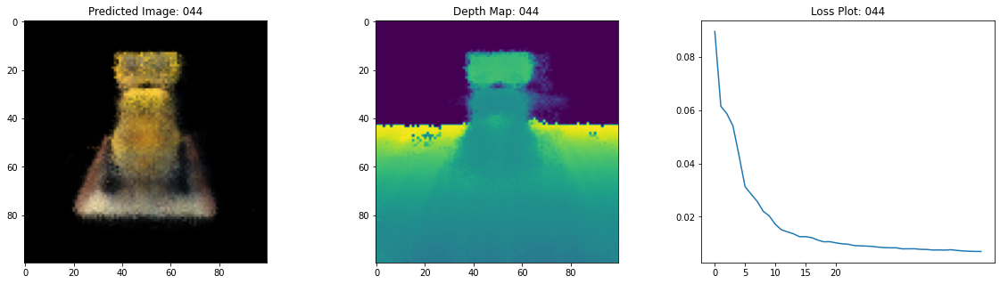

16/16 [==============================] - 25s 1s/step - loss: 0.0070 - psnr: 21.6908 - val_loss: 0.0080 - val_psnr: 21.0725
Epoch 46/50
16/16 [==============================] - ETA: 0s - loss: 0.0073 - psnr: 21.5202

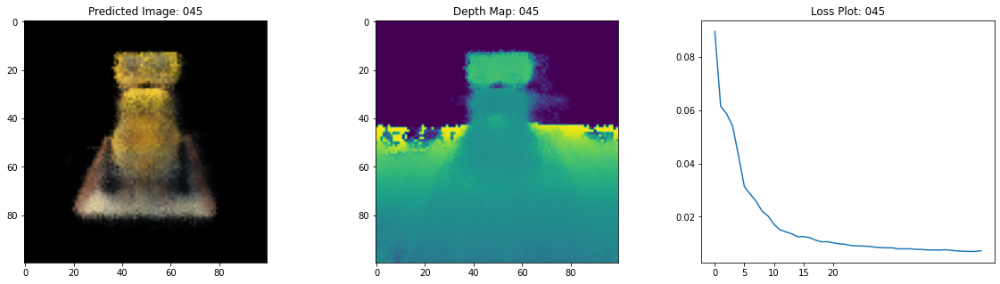

16/16 [==============================] - 24s 1s/step - loss: 0.0073 - psnr: 21.5202 - val_loss: 0.0082 - val_psnr: 20.9632
Epoch 47/50
16/16 [==============================] - ETA: 0s - loss: 0.0069 - psnr: 21.7300

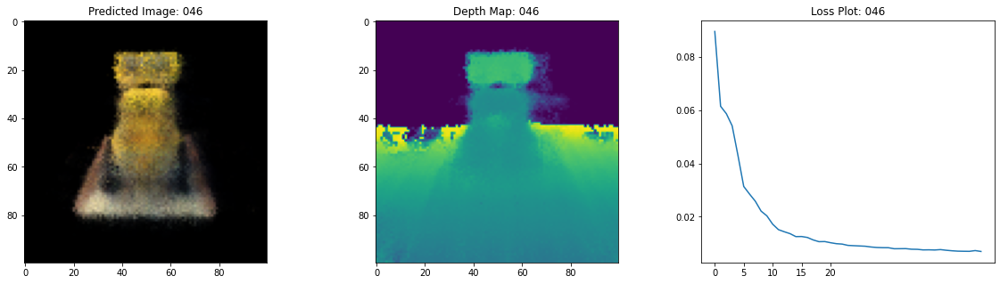

16/16 [==============================] - 24s 1s/step - loss: 0.0069 - psnr: 21.7300 - val_loss: 0.0080 - val_psnr: 21.0462
Epoch 48/50
16/16 [==============================] - ETA: 0s - loss: 0.0070 - psnr: 21.6938

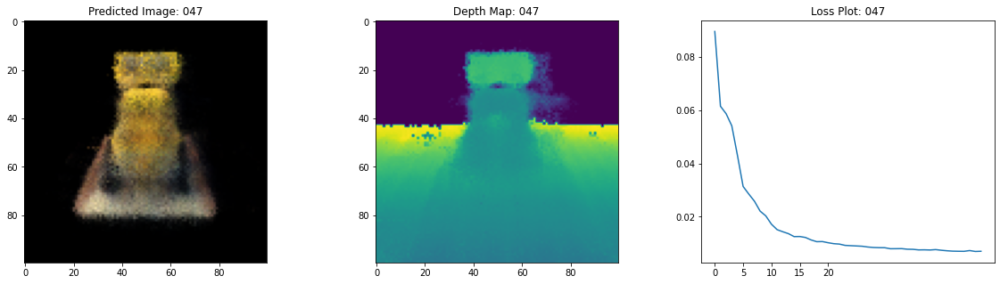

16/16 [==============================] - 24s 1s/step - loss: 0.0070 - psnr: 21.6938 - val_loss: 0.0082 - val_psnr: 20.9615
Epoch 49/50
16/16 [==============================] - ETA: 0s - loss: 0.0071 - psnr: 21.6087

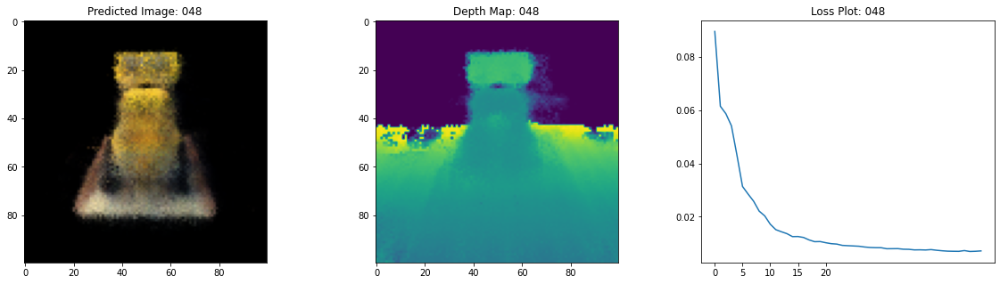

16/16 [==============================] - 24s 1s/step - loss: 0.0071 - psnr: 21.6087 - val_loss: 0.0080 - val_psnr: 21.0627
Epoch 50/50
16/16 [==============================] - ETA: 0s - loss: 0.0069 - psnr: 21.7142

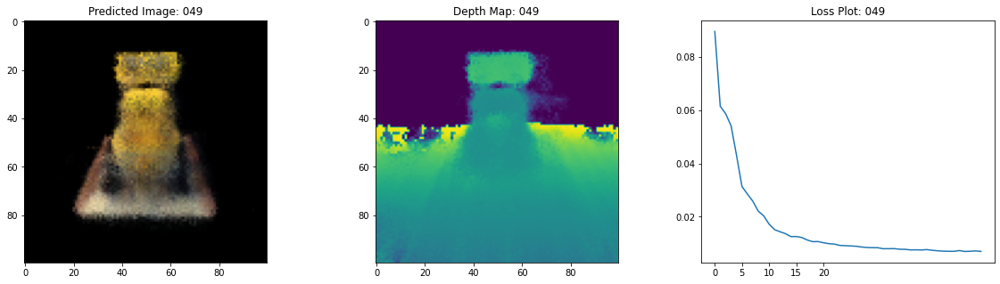

16/16 [==============================] - 25s 1s/step - loss: 0.0069 - psnr: 21.7142 - val_loss: 0.0081 - val_psnr: 20.9725


In [14]:
num_pos = H * W * NUM_SAMPLES
nerf_model = get_nerf_model(num_layers=8, num_pos=num_pos)

model = NeRF(nerf_model)
model.compile(
    optimizer=keras.optimizers.Adam(), loss_fn=keras.losses.MeanSquaredError()
)

# Create a directory to save the images during training.
if not os.path.exists("images"):
    os.makedirs("images")

model.fit(
    train_ds,
    validation_data=val_ds,
    batch_size=BATCH_SIZE,
    epochs=50,
    callbacks=[TrainMonitor()],
    steps_per_epoch=split_index // BATCH_SIZE,
)

### Visualize the training step
Here we see the training step. With the decreasing loss, the rendered
image and the depth maps are getting better.
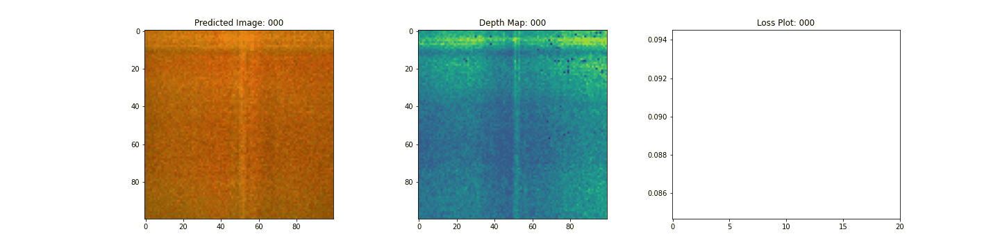

In [15]:
def create_gif(path_to_images, name_gif):
    filenames = glob.glob(path_to_images)
    filenames = sorted(filenames)
    images = []
    for filename in tqdm(filenames):
        images.append(imageio.imread(filename))
    kargs = {"duration": 0.25}
    imageio.mimsave(name_gif, images, "GIF", **kargs)

In [16]:
create_gif("images/*.png", "training.gif")

100%|██████████| 50/50 [00:00<00:00, 72.88it/s]


### Inference
In this section, we ask the model to build novel views of the scene.
The model was given `106` views of the scene in the training step. The
collections of training images cannot contain each and every angle of
the scene. A trained model can represent the entire 3-D scene with a
sparse set of training images.
Here we provide different poses to the model and ask for it to give us
the 2-D image corresponding to that camera view. If we infer the model
for all the 360-degree views, it should provide an overview of the
entire scenery from all around.

In [17]:
nerf_model = model.nerf_model
test_recons_images, depth_maps = render_rgb_depth(
    model=nerf_model,
    rays_flat=test_rays_flat,
    t_vals=test_t_vals,
    rand=True,
    train=False,
)

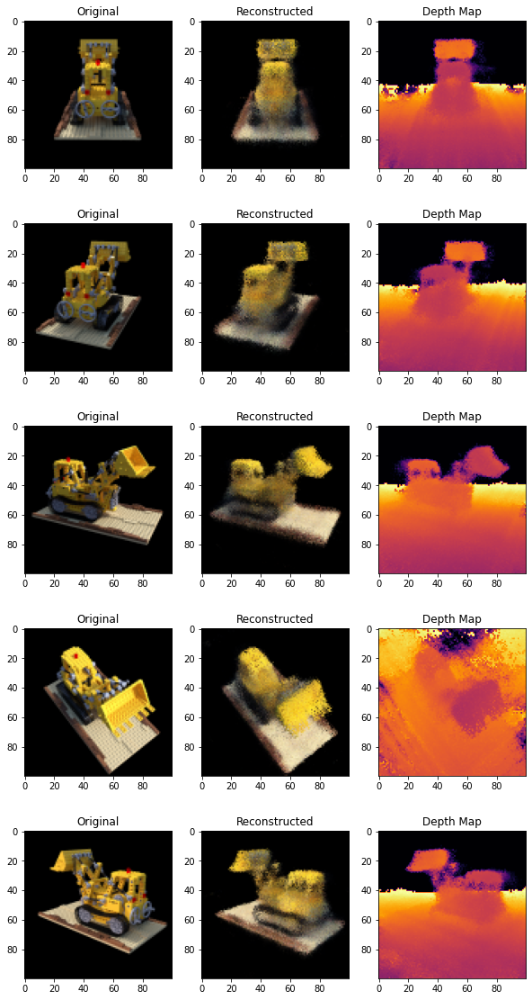

In [18]:
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(10, 20))

for ax, ori_img, recons_img, depth_map in zip( axes, test_imgs, 
                                              test_recons_images, depth_maps):
    ax[0].imshow(keras.preprocessing.image.array_to_img(ori_img))
    ax[0].set_title("Original")

    ax[1].imshow(keras.preprocessing.image.array_to_img(recons_img))
    ax[1].set_title("Reconstructed")

    ax[2].imshow(
        keras.preprocessing.image.array_to_img(depth_map[..., None]), cmap="inferno"
    )
    ax[2].set_title("Depth Map")

### Rendering 3D Scene
Here we will synthesize novel 3D views and stitch all of them together
to render a video encompassing the 360-degree view.

In [19]:
def get_translation_t(t):
    """Get the translation matrix for movement in t."""
    matrix = [
        [1, 0, 0, 0],
        [0, 1, 0, 0],
        [0, 0, 1, t],
        [0, 0, 0, 1],
    ]
    return tf.convert_to_tensor(matrix, dtype=tf.float32)

In [20]:
def get_rotation_phi(phi):
    """Get the rotation matrix for movement in phi."""
    matrix = [
        [1, 0, 0, 0],
        [0, tf.cos(phi), -tf.sin(phi), 0],
        [0, tf.sin(phi), tf.cos(phi), 0],
        [0, 0, 0, 1],
    ]
    return tf.convert_to_tensor(matrix, dtype=tf.float32)

In [21]:
def get_rotation_theta(theta):
    """Get the rotation matrix for movement in theta."""
    matrix = [
        [tf.cos(theta), 0, -tf.sin(theta), 0],
        [0, 1, 0, 0],
        [tf.sin(theta), 0, tf.cos(theta), 0],
        [0, 0, 0, 1],
    ]
    return tf.convert_to_tensor(matrix, dtype=tf.float32)

In [22]:
def pose_spherical(theta, phi, t):
    """
    Get the camera to world matrix for the corresponding theta, phi
    and t.
    """
    c2w = get_translation_t(t)
    c2w = get_rotation_phi(phi / 180.0 * np.pi) @ c2w
    c2w = get_rotation_theta(theta / 180.0 * np.pi) @ c2w
    c2w = np.array([[-1, 0, 0, 0], [0, 0, 1, 0], [0, 1, 0, 0], [0, 0, 0, 1]]) @ c2w
    return c2w

In [23]:
rgb_frames = []
batch_flat = []
batch_t = []

In [24]:
# Iterate over different theta value and generate scenes.
for index, theta in tqdm(enumerate(np.linspace(0.0, 360.0, 120, endpoint=False))):
    # Get the camera to world matrix.
    c2w = pose_spherical(theta, -30.0, 4.0)

    #
    ray_oris, ray_dirs = get_rays(H, W, focal, c2w)
    rays_flat, t_vals = render_flat_rays(
        ray_oris, ray_dirs, near=2.0, far=6.0, num_samples=NUM_SAMPLES, rand=False
    )

    if index % BATCH_SIZE == 0 and index > 0:
        batched_flat = tf.stack(batch_flat, axis=0)
        batch_flat = [rays_flat]

        batched_t = tf.stack(batch_t, axis=0)
        batch_t = [t_vals]

        rgb, _ = render_rgb_depth(
            nerf_model, batched_flat, batched_t, rand=False, train=False
        )

        temp_rgb = [np.clip(255 * img, 0.0, 255.0).astype(np.uint8) for img in rgb]

        rgb_frames = rgb_frames + temp_rgb
    else:
        batch_flat.append(rays_flat)
        batch_t.append(t_vals)

120it [00:25,  4.71it/s]


In [25]:
!pip install imageio-ffmpeg
rgb_video = "rgb_video.mp4"
imageio.mimwrite(rgb_video, rgb_frames, fps=30, quality=7, macro_block_size=None)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


### Visualize the video
Here we can see the rendered 360 degree view of the scene on the video inside the Repo. The model
has successfully learned the entire volumetric space through the
sparse set of images in **only 50 epochs**.

## Paper Results
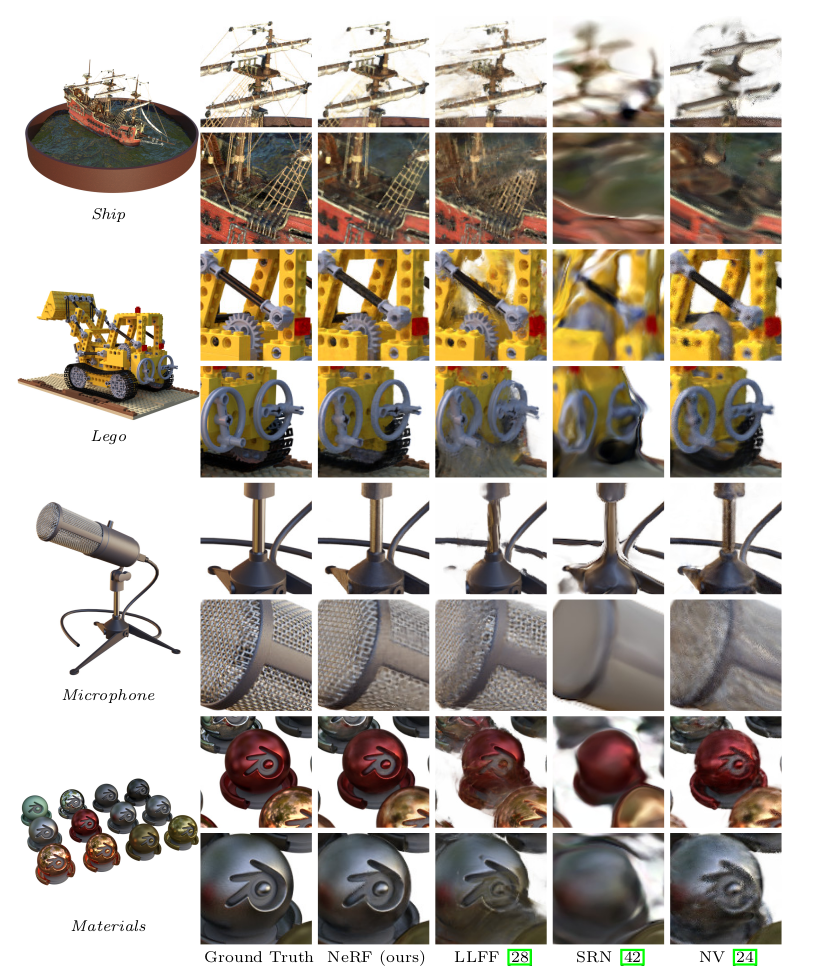
Here is a comparisons on test-set views for scenes from the new synthetic dataset
generated with a physically-based renderer. the new method is able to recover fine
details in both geometry and appearance, such as Ship’s rigging, Lego’s gear
and treads, Microphone’s shiny stand and mesh grille, and Material ’s non-
Lambertian reflectance. LLFF exhibits banding artifacts on the Microphone
stand and Material ’s object edges and ghosting artifacts in Ship’s mast and
inside the Lego object. SRN produces blurry and distorted renderings in every
case. Neural Volumes cannot capture the details on the Microphone’s grille or
Lego’s gears, and it completely fails to recover the geometry of Ship’s rigging.

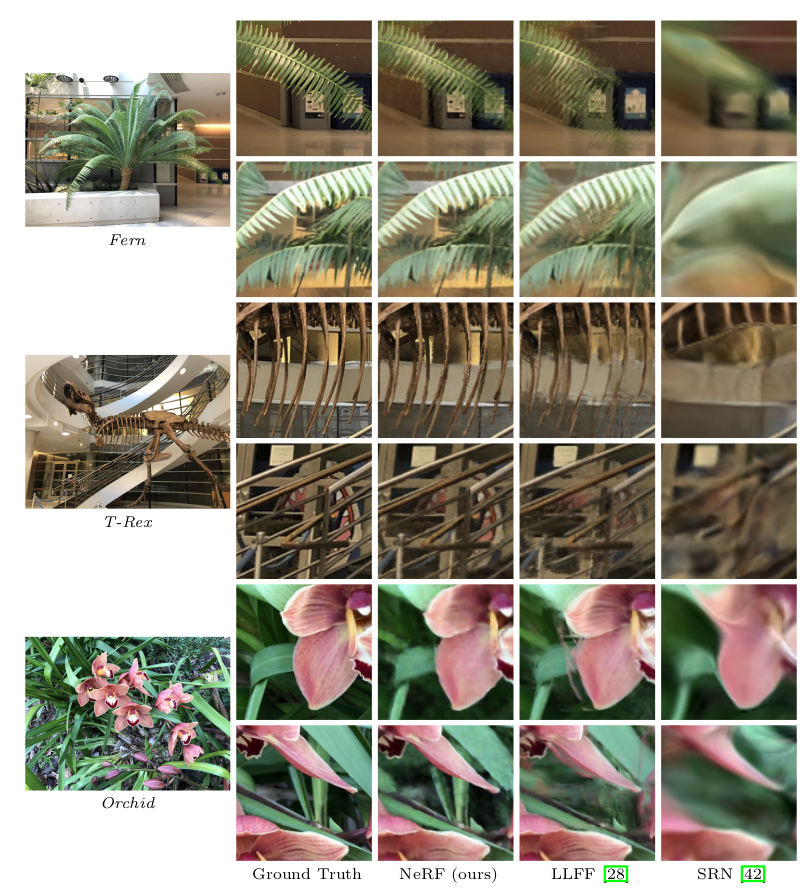

Here is a comparisons on test-set views of real world scenes. LLFF is specifically
designed for this use case (forward-facing captures of real scenes). the new method
is able to represent fine geometry more consistently across rendered views than
LLFF, as shown in Fern’s leaves and the skeleton ribs and railing in T-rex.
the new method also correctly reconstructs partially occluded regions that LLFF
struggles to render cleanly, such as the yellow shelves behind the leaves in the
bottom Fern crop and green leaves in the background of the bottom Orchid crop.
Blending between multiples renderings can also cause repeated edges in LLFF,
as seen in the top Orchid crop. SRN captures the low-frequency geometry and
color variation in each scene but is unable to reproduce any fine detail.

# Conclusion
There is no doubt that there has been a great deal of research on 3d imaging and all other computer vision applications that would enhance our lives in the very near future. That's why I've put an effort here trying to wrap the implementation provided by Aritra Roy Gosthipaty up with a quick explanation of the paper itself to put it as a milestone for anyone trying to dig into the topic from an applicable prespective. I've also modified the architecture of the neural network a little bit to improve the performance of the model. I really appretiate the great work done here in this paper by the researchers as actually the preliminary results are really promising and of course there has been many improvements in the field when it comes to NeRFs but this paper is considered a really good start to dig deeper into the topic.
###### Credits for the researchers behind this work
- Ben Mildenhall 
- Pratul P. Srinivasan
- Matthew Tancik 
- Jonathan T. Barron 
- Ravi Ramamoorthi 
- Ren Ng 
- UC Berkeley
- Google Research
- UC San Diego